In [1]:
%pip install gensim

Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip available: 22.3.1 -> 23.3.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [2]:
%pip install textblob

Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip available: 22.3.1 -> 23.3.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [3]:
import pandas as pd
import numpy as np
import collections
import gensim 
from gensim.models import word2vec, phrases
from gensim.parsing.preprocessing import remove_stopwords, strip_punctuation, strip_numeric,\
                    strip_non_alphanum, strip_multiple_whitespaces, strip_short
from textblob import TextBlob, Word

import re
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import seaborn as sns
%matplotlib inline


In [4]:
#load the recipes dataset
filepath = "recipes.csv"
df_recipes = pd.read_csv(filepath, encoding="ISO-8859-1")

#drop rows where cuisine, ingregients are NA
df_recipes.dropna(subset=['cuisine', 'ingredients'],inplace=True)
df_recipes

,id,recipeName,rating,totalTimeInSeconds,course,cuisine,ingredients
0,Southern-Cornbread-Dressing-1357820,Southern Cornbread Dressing,4.0,3600.0,NaN,[Southern & Soul Food],"[buttermilk cornbread, sandwich bread, salt, b..."
1,Peanut-butter-fudge-297693,Peanut Butter Fudge,4.0,8100.0,[Desserts],[American],"[Country Crock® Spread, light corn syrup, crea..."
2,Buckeyes-298471,Buckeyes,4.0,6600.0,[Desserts],[American],"[Skippy® Super Chunk® Peanut Butter, Country C..."
3,Disappearing-buffalo-chicken-dip-297712,Disappearing Buffalo Chicken Dip,4.0,2100.0,[Appetizers],[American],"[light mayonnaise, lemon juice, cayenne pepper..."
4,Classic-macaroni-salad-304692,Classic Macaroni Salad,4.0,1500.0,"[Salads, Side Dishes]",[American],"[elbow macaroni, hellmann' or best food real m..."
...,...,...,...,...,...,...,...
5469,Chicken-Teriyaki-573526,Chicken Teriyaki,4.0,2700.0,[Main Dishes],[Japanese],"[chicken thighs, light soy sauce, mirin, sake,..."
5470,Miso-Soup-1225759,Miso Soup,4.0,600.0,[Soups],[Japanese],"[dashi, miso, silken tofu, wakame, green onion..."
5471,Miso-Marinated-Pork-_butaniku-no-misozuke_-751346,Miso Marinated Pork (butaniku no misozuke),4.0,2400.0,[Main Dishes],[Japanese],"[pork cutlets, white miso, red miso, fresh gin..."
5472,Japanese-Street-Food-Recipe---Chicken-Karaage-...,Japanese Street Food Recipe - Chicken Karaage,4.0,2700.0,[Main Dishes],"[Japanese, Asian]","[chicken legs, sake, soy sauce, ginger, potato..."


In [5]:
import nltk
nltk.download('punkt')

[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\ajava\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!


True

In [6]:
#convert to lower case
df_recipes['ingredients'] = df_recipes['ingredients'].apply(lambda x: x.lower())
# df_recipes['recipeName'] = df_recipes['recipeName'].apply(lambda x: x.lower())

total_ingredients = []
all_receipes_ingredients =  []
# all_recipes_ = []
for i in range(len(df_recipes)):
    all_ingredients = list()
    all_recipes = list()
    #split each recipe into different ingredients
    ingred = df_recipes.loc[i, "ingredients"][1:-1]
    # recip = df_recipes.loc[i,"recipeName"]
    for ing in (ingred.split(',')):
        ing = remove_stopwords(ing)
        ing = strip_numeric(ing)
        ing = re.sub(r'\(.*oz.\)|(®)|(.*ed)|(.*ly)|boneless|skinless|chunks|fresh|large|cook drain|green|frozen|ground','',ing).strip()
        ing = strip_short(ing,2)
        ing = strip_multiple_whitespaces(ing)
        ing = strip_punctuation(ing)
        ing = strip_non_alphanum(ing)
        
        #convert plurals to singular e.g. tomatoes --> tomato
        ing = (" ".join(TextBlob(ing).words.singularize()))
        
        all_ingredients.append(ing)
        total_ingredients.append(ing)
        # all_recipes.append(recip) 
    # all_recipes_.append(all_recipes)
    all_receipes_ingredients.append(all_ingredients)
    
counts_ingr = collections.Counter(total_ingredients)

print('Total Ingredients (with repetition):  \t{}'.format((len(total_ingredients))))
print('Unique Ingredients : \t\t\t{}'.format((len(counts_ingr.values()))))
print('Total Receipes:  \t\t\t{}'.format((len(all_receipes_ingredients))))


Total Ingredients (with repetition):  	55047
Unique Ingredients : 			2633
Total Receipes:  			5474


In [7]:
np.array(all_receipes_ingredients).shape    

c:\Users\ajava\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:1: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  """Entry point for launching an IPython kernel.


(5474,)

In [8]:
#add cleaned ingredients back to original dataframe
df_recipes['clean_ingredients'] = pd.Series(all_receipes_ingredients)

#record the number of ingredients for each recipe
df_recipes['ingredient_count'] =  df_recipes.apply(lambda row: len(row['clean_ingredients']), axis = 1)

#convert time in seconds to minutes
df_recipes['timeMins'] = df_recipes.totalTimeInSeconds.apply(lambda x: x/60) 

In [9]:
print(np.mean(list(counts_ingr.values())))
print(np.std(list(counts_ingr.values())))
print(np.median(list(counts_ingr.values())))
print(np.percentile(list(counts_ingr.values()), [25., 50., 75., 99.]))

20.906570451955943
99.1628173432985
2.0
[  1.     2.     7.   378.36]


In [10]:
#find the most common ingredients used across all recipes
print ("---- Most Common Ingredients ----")
print (counts_ingr.most_common(10))

print ("\n")

#find the most common ingredients used across all recipes
print ("---- Least Common Ingredients ----")
print (counts_ingr.most_common()[-10:])


---- Most Common Ingredients ----
[('salt', 2377), ('onion', 1794), ('garlic', 1484), ('pepper', 1208), ('butter', 1160), ('black pepper', 1020), ('sugar', 1019), ('olive oil', 897), ('water', 881), ('egg', 845)]


---- Least Common Ingredients ----
[('orecchiette', 1), ('gorgonzola', 1), ('ciabattum bun', 1), ('bertolli', 1), ('liquid egg substitute', 1), ('delallo extra virgin olive oil', 1), ('sourdough baguette', 1), ('mentsuyu', 1), ('canola oil cooking spray', 1), ('wakame', 1)]


In [11]:
%pip install wordcloud

Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip available: 22.3.1 -> 23.3.1
[notice] To update, run: python.exe -m pip install --upgrade pip


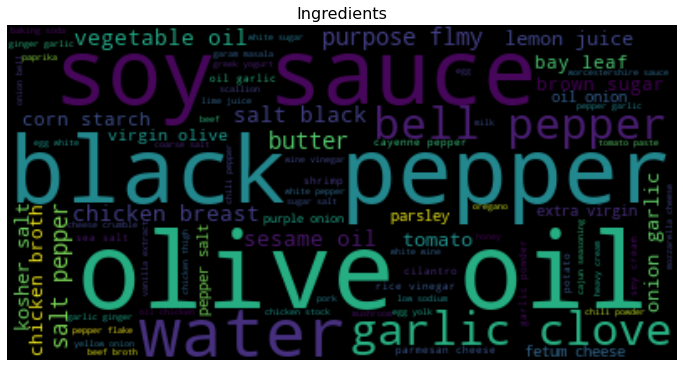

In [12]:
#visualize the ingredients in WordCloud 

from wordcloud import WordCloud

def plot_wordcloud(text, title=None, max = 1000, size=(12,8), title_size=16):
    """plots wordcloud"""
    wordcloud = WordCloud(max_words=max).generate(text)
    plt.figure(figsize=size)
    plt.title(title, size=title_size)
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis("off")

plot_wordcloud(' '.join(total_ingredients), title='Ingredients')

In [13]:
#Train the Word2Vec model

num_features = 300    # Word vector dimensionality                      
min_word_count = 4                        
num_workers = 4       # Number of CPUs
context = 10          # Context window size; 

downsampling = 1e-2   # threshold for configuring which 
                      # higher-frequency words are randomly downsampled
            
# Initialize and train the model 
model = word2vec.Word2Vec(all_receipes_ingredients, workers=num_workers, \
            vector_size=num_features, min_count = min_word_count, \
            window = context,sample = downsampling)

# If you don't plan to train the model any further, calling 
# init_sims will make the model much more memory-efficient.
model.init_sims(replace=True)

c:\Users\ajava\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:18: DeprecationWarning: Call to deprecated `init_sims` (Gensim 4.0.0 implemented internal optimizations that make calls to init_sims() unnecessary. init_sims() is now obsoleted and will be completely removed in future versions. See https://github.com/RaRe-Technologies/gensim/wiki/Migrating-from-Gensim-3.x-to-4).


In [14]:
# check the similar ingredients returned by the model for search_terms

similar_words = {search_term: [item[0] for item in model.wv.most_similar([search_term], topn=5)]
                  for search_term in ['paneer','egg','mango','bread', 'rice']}
similar_words

{'paneer': ['garlic paste',
  'lemongras',
  'ginger paste',
  'curry powder',
  'gram flmy'],
 'egg': ['milk',
  'active dry yeast',
  'all purpose flmy',
  'egg yolk',
  'instant yeast'],
 'mango': ['apple cider vinegar',
  'orange',
  'club soda',
  'vinegar',
  'dark sesame oil'],
 'bread': ['grain bread',
  'ranch dressing',
  'provolone cheese',
  'turkey breast',
  'arborio rice'],
 'rice': ['pea', 'chow mein noodle', 'chicken', 'cabbage', 'mung bean sprout']}

c:\Users\ajava\AppData\Local\Programs\Python\Python37\lib\site-packages\sklearn\manifold\_t_sne.py:783: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  FutureWarning,
c:\Users\ajava\AppData\Local\Programs\Python\Python37\lib\site-packages\sklearn\manifold\_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,


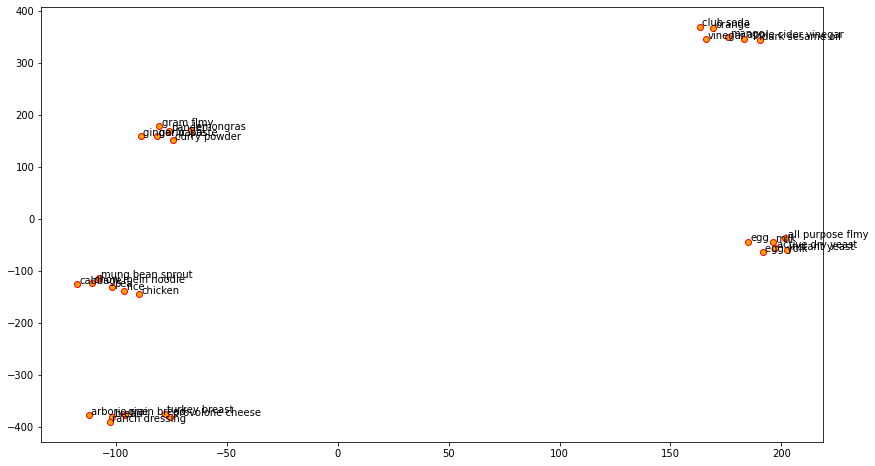

In [15]:
#visualization with Tsne
from sklearn.manifold import TSNE

words = sum([[k] + v for k, v in similar_words.items()], [])
wvs = model.wv[words]
tsne = TSNE(n_components=2, random_state=0, n_iter=1000, perplexity=2)
np.set_printoptions(suppress=True)
T = tsne.fit_transform(wvs)
labels = words

plt.figure(figsize=(14, 8))
plt.scatter(T[:, 0], T[:, 1], c='orange', edgecolors='r')
for label, x, y in zip(labels, T[:, 0], T[:, 1]):
    plt.annotate(label, xy=(x+1, y+1), xytext=(0, 0), textcoords='offset points')

In [16]:
all_receipes_ingredients

[['buttermilk cornbread',
  'sandwich bread',
  'salt',
  'black pepper',
  'sage',
  'egg',
  'onion',
  'celery',
  'butter',
  'cream chicken soup',
  'chicken stock'],
 ['country crock spread',
  'light corn syrup',
  'creamy peanut butter',
  'confectioner sugar',
  'vanilla extract'],
 ['skippy super chunk peanut butter',
  'country crock spread',
  'confectioner sugar',
  'semi sweet chocolate morsel'],
 ['light mayonnaise',
  'lemon juice',
  'cayenne pepper sauce',
  'blue cheese',
  'chive',
  'dar cheese',
  'chicken'],
 ['elbow macaroni',
  'hellmann best food real mayonnai',
  'vinegar white white',
  'wine',
  '',
  'hellmann s dijonnaise creamy dijon mustard',
  'sugar',
  'salt',
  'black pepper',
  'celery',
  'bell pepper',
  'slouse',
  'onion'],
 ['hellmann best food real mayonnai',
  'lemon juice',
  'sugar',
  'salt',
  'cabbage',
  'carrot',
  'bell pepper'],
 ['fat milk', 'butter', 'flmy', 'fine sea salt', 'black pepper', 'nutmeg'],
 ['skippy creamy peanut butte

In [17]:
model.wv.most_similar_cosmul(positive=['paneer', u'chicken'], negative=['tomato sauce'])

[('rice flmy', 1.3897797691429814),
 ('vermicelli', 1.3040165304574864),
 ('rice vinegar', 1.2826649064886442),
 ('potato starch', 1.2703827971757358),
 ('napa cabbage', 1.267618941960989),
 ('luncheon meat', 1.25901874000959),
 ('iceberg lettuce', 1.2563359104841099),
 ('sesame oil', 1.2517527438686318),
 ('chily', 1.2516468288572278),
 ('oil', 1.2478038314718538)]

In [18]:
model.wv.most_similar('oil')


[('sesame oil', 0.9649665355682373),
 ('chili pepper', 0.9599249362945557),
 ('peanut oil', 0.9454456567764282),
 ('peanut', 0.9429553747177124),
 ('rice vinegar', 0.9420708417892456),
 ('hoisin sauce', 0.9392696022987366),
 ('cooking oil', 0.9334259033203125),
 ('oyster sauce', 0.9298081994056702),
 ('low sodium soy sauce', 0.9289504289627075),
 ('ginger root', 0.9267480373382568)]

In [19]:
model.wv.most_similar('vermicelli')


[('water chestnut', 0.9444003105163574),
 ('extra firm tofu', 0.9388534426689148),
 ('rice vinegar', 0.9363894462585449),
 ('napa cabbage', 0.9344077110290527),
 ('low sodium soy sauce', 0.9320859909057617),
 ('sriracha', 0.9249931573867798),
 ('chily', 0.905228316783905),
 ('peanut', 0.9009371399879456),
 ('pineapple slice', 0.897938072681427),
 ('beansprout', 0.8973066806793213)]

In [21]:
model.wv.most_similar('mayonnaise')

[('bread ciabattum', 0.9938474893569946),
 ('tomato oil', 0.9924271106719971),
 ('light smy cream', 0.9881759881973267),
 ('cut italian loaf', 0.9880515336990356),
 ('turkey', 0.9879554510116577),
 ('basil pesto sauce', 0.9869698286056519),
 ('turkey breast', 0.9866427183151245),
 ('artichoke heart', 0.9855560064315796),
 ('best food mayonnaise dressing extra virgin olive oil', 0.9850419759750366),
 ('olive oil cooking spray', 0.9848835468292236)]

In [22]:
model.wv.similarity('paneer', 'chicken')

0.89405566

In [23]:
model.wv.doesnt_match("chicken paneer lentils meat".split())

'paneer'

In [24]:
x = 'bread'
b= 'cheese'
a = 'bread'
predicted = model.wv.most_similar([x, b], [a])[0][0]
print(" {} is to  {} as {} is to {} ".format(a, b, x, predicted))

 bread is to  cheese as bread is to baby spinach leaf 


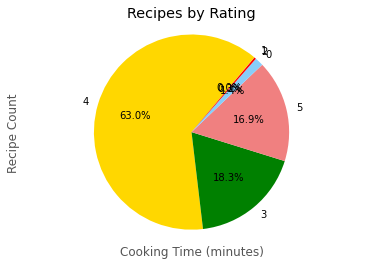

In [25]:
plt.style.available
plt.style.use('ggplot')

plt.xlabel('Cooking Time (minutes)')
plt.ylabel('Recipe Count')

labels = ['4', '3', '5', '0', '2', '1']
plt.pie(df_recipes.rating.value_counts(), labels=labels, autopct='%1.1f%%', colors=['gold', 'green', 'lightcoral', 'lightskyblue', 'red'], startangle=50, pctdistance=0.6)
plt.axis('equal')
plt.title('Recipes by Rating')
plt.show()

Text(0.5, 1.0, 'Ingredient Counts vs Ratings')

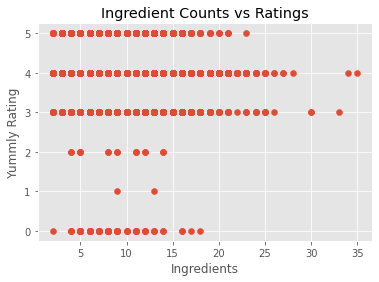

In [26]:
# ingredient/rating relationship?

feature_cols = ['ingredient_count']
X= df_recipes[feature_cols]
y= df_recipes.rating
plt.scatter(X, y)
plt.xlabel('Ingredients')
plt.ylabel('Yummly Rating')
plt.title('Ingredient Counts vs Ratings')

Text(0.5, 1.0, 'Cooking Time vs Ratings')

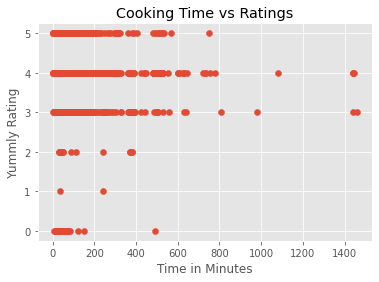

In [27]:
feature_cols = ['timeMins']
X= df_recipes.dropna()[feature_cols]
y= df_recipes.dropna().rating
plt.scatter(X, y)
plt.xlabel('Time in Minutes')
plt.ylabel('Yummly Rating')
plt.title('Cooking Time vs Ratings')


Text(0.5, 1.0, 'Ingredients vs. Cooking Times')

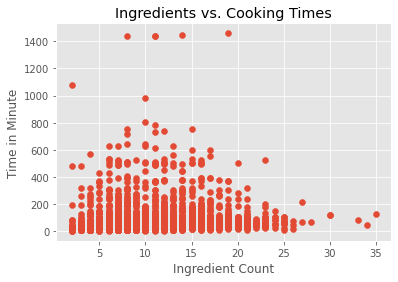

In [28]:
# ingredients/cooking time relationship?
feature_cols = ['ingredient_count']
X= df_recipes.dropna()[feature_cols]
y= df_recipes.dropna()['timeMins']
plt.scatter(X, y)
plt.xlabel('Ingredient Count')
plt.ylabel('Time in Minute')
plt.title('Ingredients vs. Cooking Times')


In [29]:
df_indian = df_recipes[df_recipes.cuisine.str.contains("indian", case=False)].copy()

ingredients =df_indian["clean_ingredients"].sum()

counts = collections.Counter(ingredients)

counts.most_common(30)


[('salt', 275),
 ('', 270),
 ('onion', 208),
 ('ginger', 182),
 ('garam masala', 177),
 ('coriander', 135),
 ('garlic', 127),
 ('tomato', 126),
 ('chili powder', 125),
 ('cumin', 124),
 ('turmeric', 113),
 ('oil', 99),
 ('chily', 96),
 ('water', 93),
 ('cilantro', 79),
 ('clove', 76),
 ('tumeric', 75),
 ('garlic clove', 69),
 ('cardamom', 66),
 ('vegetable oil', 60),
 ('cilantro leaf', 59),
 ('yoghurt', 56),
 ('cinnamon', 55),
 ('butter', 52),
 ('black pepper', 51),
 ('lemon juice', 49),
 ('coriander powder', 48),
 ('pepper', 45),
 ('ghee', 44),
 ('bay leaf', 44)]

In [30]:
# check the similar ingredients returned by the model for search_terms

similar_words = {search_term: [item[0] for item in model.wv.most_similar([search_term], topn=5)]
                  for search_term in ['paneer']}
similar_words

{'paneer': ['garlic paste',
  'lemongras',
  'ginger paste',
  'curry powder',
  'gram flmy']}

In [31]:
model.wv.vectors.shape

(1052, 300)

In [32]:
word_to_vector = {word: model.wv.get_vector(word) for word in model.wv.index_to_key}


In [33]:
word_to_vector.keys()

dict_keys(['salt', 'onion', 'garlic', 'pepper', 'butter', 'black pepper', 'sugar', 'olive oil', 'water', 'egg', '', 'ginger', 'tomato', 'garlic clove', 'soy sauce', 'bell pepper', 'all purpose flmy', 'vegetable oil', 'oregano', 'sesame oil', 'lemon juice', 'kosher salt', 'milk', 'paprika', 'parsley', 'chicken breast', 'oil', 'corn starch', 'carrot', 'bay leaf', 'flmy', 'extra virgin olive oil', 'cumin', 'thyme', 'brown sugar', 'cilantro', 'purple onion', 'scallion', 'parmesan cheese', 'celery', 'honey', 'potato', 'cayenne pepper', 'shrimp', 'rice vinegar', 'garlic powder', 'lemon', 'pepper flake', 'cinnamon', 'cajun seasoning', 'cucumber', 'smy cream', 'chicken broth', 'tomato paste', 'yellow onion', 'chili powder', 'chicken', 'sea salt', 'heavy cream', 'garam masala', 'basil', 'white sugar', 'vanilla extract', 'lime juice', 'worcestershire sauce', 'coriander', 'chicken stock', 'beef', 'pineapple', 'rice', 'white pepper', 'fetum cheese', 'baking soda', 'mushroom', 'bacon', 'clove', 'co

In [34]:
ingredient_to_check = 'cornbread'

if ingredient_to_check.lower() in word_to_vector:
    print(f"{ingredient_to_check} is in the vocabulary, and its vector is:")
    print(word_to_vector[ingredient_to_check.lower()])
else:
    print(f"{ingredient_to_check} is not in the vocabulary.")


cornbread is not in the vocabulary.


In [35]:
df_recipes.at[3,"clean_ingredients"]

['light mayonnaise',
 'lemon juice',
 'cayenne pepper sauce',
 'blue cheese',
 'chive',
 'dar cheese',
 'chicken']

In [36]:
df_recipes.head()

,id,recipeName,rating,totalTimeInSeconds,course,cuisine,ingredients,clean_ingredients,ingredient_count,timeMins
0,Southern-Cornbread-Dressing-1357820,Southern Cornbread Dressing,4.0,3600.0,NaN,[Southern & Soul Food],"[buttermilk cornbread, sandwich bread, salt, b...","[buttermilk cornbread, sandwich bread, salt, b...",11,60.0
1,Peanut-butter-fudge-297693,Peanut Butter Fudge,4.0,8100.0,[Desserts],[American],"[country crock® spread, light corn syrup, crea...","[country crock spread, light corn syrup, cream...",5,135.0
2,Buckeyes-298471,Buckeyes,4.0,6600.0,[Desserts],[American],"[skippy® super chunk® peanut butter, country c...","[skippy super chunk peanut butter, country cro...",4,110.0
3,Disappearing-buffalo-chicken-dip-297712,Disappearing Buffalo Chicken Dip,4.0,2100.0,[Appetizers],[American],"[light mayonnaise, lemon juice, cayenne pepper...","[light mayonnaise, lemon juice, cayenne pepper...",7,35.0
4,Classic-macaroni-salad-304692,Classic Macaroni Salad,4.0,1500.0,"[Salads, Side Dishes]",[American],"[elbow macaroni, hellmann' or best food real m...","[elbow macaroni, hellmann best food real mayon...",13,25.0


In [37]:
def check_ingredient_in_vectors(ingredient_to_check):

    if ingredient_to_check.lower() in word_to_vector:
        print(word_to_vector[ingredient_to_check.lower()])
        return True
    else:
        print(f"{ingredient_to_check} is not in the vocabulary.")
        return False

In [38]:
check_ingredient_in_vectors('salt')

[ 0.02233155  0.05223505  0.04884888  0.11318301 -0.06438003 -0.09476663
  0.06026381  0.22523879 -0.04281887 -0.04402273  0.05273762 -0.05272925
 -0.02223526  0.05443079 -0.06669308 -0.09438426  0.08758482  0.01784418
 -0.04165273 -0.10083289 -0.01482287 -0.03782404  0.15950549  0.08169401
  0.04659178 -0.04169841 -0.12345285  0.02040672 -0.1069917  -0.0301109
 -0.06426844 -0.06568974  0.07816487 -0.14929888  0.0325877  -0.04245638
  0.01122167 -0.0351031   0.03912276 -0.06204207 -0.13694999 -0.00541545
 -0.02350055 -0.0093528  -0.0043182  -0.05015313 -0.03163466  0.02080165
 -0.00885733  0.03584421 -0.04811539  0.0347349  -0.04434956 -0.07457866
  0.04110831 -0.04276375 -0.02632511 -0.0191395  -0.06624751  0.00883622
 -0.00536081 -0.05209791 -0.12666552 -0.03444024  0.00770502  0.05201285
  0.06931234  0.05584168 -0.04956982  0.05898279  0.06248254  0.00554822
 -0.02661005  0.00477587 -0.02192263 -0.03136883  0.04826364  0.00743754
 -0.00746814 -0.02718593 -0.00696045  0.00556087  0.

True

In [39]:
ingredients = df_recipes.loc[df_recipes['recipeName'] == 'Disappearing Buffalo Chicken Dip']["ingredients"].values[0][1:-1].split(',')


In [40]:
def all_subwords(input_str):
    words = input_str.split()
    subwords = []

    for i in range(len(words)):
        for j in range(i + 1, len(words) + 1):
            subword = ' '.join(words[i:j])
            if subword != input_str:
                subwords.append(subword)

    return subwords

input_string = "pepper sauce"
result = all_subwords(input_string)

print(result)

['pepper', 'sauce']


In [41]:
def get_vector(recipe_name):
    final_vector = []
    considered_ingredients = []
    ingredients = df_recipes.loc[df_recipes['recipeName'] == recipe_name]["ingredients"].values[0][1:-1].split(',')
    print(ingredients)
    ingredients = [x.strip(' ') for x in ingredients]
    print(ingredients)
    sub_ing=''
    for ing in ingredients:
        print(ing)
        if not check_ingredient_in_vectors(ing):
            sub_ingredients = all_subwords(ing)
            print(sub_ingredients)
            for sub_ing in sub_ingredients:
                print(sub_ing)
                if not check_ingredient_in_vectors(sub_ing):
                    print(sub_ing+" is not in dictionary")
                else:
                    final_vector.append(word_to_vector[sub_ing.lower()])  
                    print("I Just considered this!: ", sub_ing)
                    considered_ingredients.append(sub_ing)
        else:
            # final_vector.append([word_to_vector[sub_ing.lower()]])
            print(ing, "blaa")
            final_vector.append(word_to_vector[ing.lower()])
            print("I Just considered this!: ", ing)

            considered_ingredients.append(sub_ing)
    print(final_vector)
    
    average_final_vector = np.mean(final_vector, axis=0)

    return average_final_vector


In [42]:
average_final_vector = get_vector("Southern Cornbread Dressing")

['buttermilk cornbread', ' sandwich bread', ' salt', ' black pepper', ' rubbed sage', ' eggs', ' onions', ' celery', ' butter', ' cream of chicken soup', ' chicken stock']
['buttermilk cornbread', 'sandwich bread', 'salt', 'black pepper', 'rubbed sage', 'eggs', 'onions', 'celery', 'butter', 'cream of chicken soup', 'chicken stock']
buttermilk cornbread
buttermilk cornbread is not in the vocabulary.
['buttermilk', 'cornbread']
buttermilk
[ 0.01946671 -0.02939929 -0.00067779  0.01689994  0.04849814 -0.05169873
 -0.00996006  0.08843745 -0.02582551 -0.11371423  0.00447785 -0.08788531
  0.00179506  0.0720403  -0.0151975  -0.04043799  0.01056329  0.02719705
  0.05340071 -0.05988614 -0.03203494 -0.01648227 -0.00223715  0.0072472
 -0.02608756 -0.02346496 -0.1526911   0.09726039  0.05273407 -0.03633467
  0.06288183  0.00177896 -0.06147307  0.0165092  -0.03794965 -0.07483827
  0.01362359  0.00135716  0.04869696 -0.08416339 -0.05370701  0.04485417
 -0.02220771 -0.04508773 -0.04474342  0.00254545 

In [43]:
average_final_vector

array([-0.00866938,  0.02245687,  0.0086973 ,  0.0531868 , -0.01060678,
       -0.04954332, -0.03505806,  0.1156065 , -0.00953461, -0.02436002,
       -0.01876344, -0.03971018,  0.0171434 ,  0.05581685, -0.05563062,
       -0.04524231,  0.02173146, -0.01147007,  0.00535155, -0.04556854,
       -0.02902019, -0.00988981,  0.01985406,  0.01241154,  0.00375812,
       -0.01720476, -0.1141376 ,  0.0729479 , -0.02747401, -0.00394625,
        0.00443608, -0.0152473 ,  0.04195864,  0.00853421, -0.0681406 ,
       -0.00117923,  0.00172728, -0.01253973, -0.01398725, -0.0031953 ,
       -0.0601216 ,  0.0301904 , -0.01626313, -0.02833601,  0.00700039,
        0.01724106, -0.02416921,  0.01012274, -0.00224968,  0.05127979,
        0.00603774, -0.01281267,  0.00049212,  0.00057895,  0.06169082,
        0.02004957, -0.0040038 ,  0.01996503,  0.04520091,  0.02771928,
       -0.0324259 , -0.00408712,  0.05796193,  0.03679824, -0.02873888,
        0.01242987,  0.05858654,  0.05256971, -0.02619728,  0.02

In [44]:
smaller_df_recipes = df_recipes.head(400)
smaller_df_recipes['recipe_vector'] = smaller_df_recipes['recipeName'].apply(get_vector)

['buttermilk cornbread', ' sandwich bread', ' salt', ' black pepper', ' rubbed sage', ' eggs', ' onions', ' celery', ' butter', ' cream of chicken soup', ' chicken stock']
['buttermilk cornbread', 'sandwich bread', 'salt', 'black pepper', 'rubbed sage', 'eggs', 'onions', 'celery', 'butter', 'cream of chicken soup', 'chicken stock']
buttermilk cornbread
buttermilk cornbread is not in the vocabulary.
['buttermilk', 'cornbread']
buttermilk
[ 0.01946671 -0.02939929 -0.00067779  0.01689994  0.04849814 -0.05169873
 -0.00996006  0.08843745 -0.02582551 -0.11371423  0.00447785 -0.08788531
  0.00179506  0.0720403  -0.0151975  -0.04043799  0.01056329  0.02719705
  0.05340071 -0.05988614 -0.03203494 -0.01648227 -0.00223715  0.0072472
 -0.02608756 -0.02346496 -0.1526911   0.09726039  0.05273407 -0.03633467
  0.06288183  0.00177896 -0.06147307  0.0165092  -0.03794965 -0.07483827
  0.01362359  0.00135716  0.04869696 -0.08416339 -0.05370701  0.04485417
 -0.02220771 -0.04508773 -0.04474342  0.00254545 

c:\Users\ajava\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


In [45]:
smaller_df_recipes

,id,recipeName,rating,totalTimeInSeconds,course,cuisine,ingredients,clean_ingredients,ingredient_count,timeMins,recipe_vector
0,Southern-Cornbread-Dressing-1357820,Southern Cornbread Dressing,4.0,3600.0,NaN,[Southern & Soul Food],"[buttermilk cornbread, sandwich bread, salt, b...","[buttermilk cornbread, sandwich bread, salt, b...",11,60.0,"[-0.008669378, 0.022456866, 0.008697303, 0.053..."
1,Peanut-butter-fudge-297693,Peanut Butter Fudge,4.0,8100.0,[Desserts],[American],"[country crock® spread, light corn syrup, crea...","[country crock spread, light corn syrup, cream...",5,135.0,"[0.030860635, -0.026147868, -0.010424164, 0.03..."
2,Buckeyes-298471,Buckeyes,4.0,6600.0,[Desserts],[American],"[skippy® super chunk® peanut butter, country c...","[skippy super chunk peanut butter, country cro...",4,110.0,"[0.012683326, -0.018348452, 0.0032454357, 0.01..."
3,Disappearing-buffalo-chicken-dip-297712,Disappearing Buffalo Chicken Dip,4.0,2100.0,[Appetizers],[American],"[light mayonnaise, lemon juice, cayenne pepper...","[light mayonnaise, lemon juice, cayenne pepper...",7,35.0,"[-0.019891957, 0.02337566, 0.012849199, 0.0827..."
4,Classic-macaroni-salad-304692,Classic Macaroni Salad,4.0,1500.0,"[Salads, Side Dishes]",[American],"[elbow macaroni, hellmann' or best food real m...","[elbow macaroni, hellmann best food real mayon...",13,25.0,"[-0.012692369, 0.021626262, -0.0013610688, 0.0..."
...,...,...,...,...,...,...,...,...,...,...,...
395,Cheddar-Cheese-Sauce-MyRecipes-265675,Cheddar Cheese Sauce,4.0,600.0,[Condiments and Sauces],[American],"[1% low-fat milk, all-purpose flour, salt, sha...","[low fat milk, all purpose flmy, salt, dar che...",5,10.0,"[-0.0121692885, 0.012524364, 0.0054042493, 0.0..."
396,Brown-Sugar-Buttercream-Martha-Stewart,Brown Sugar Buttercream,5.0,1500.0,[Desserts],[American],"[large egg whites, light brown sugar, salt, un...","[egg white, light brown sugar, salt, butter]",4,25.0,"[0.016287457, -0.0024263002, 0.0279196, 0.0369..."
397,Carne-Asada-Marinade-Allrecipes,Carne Asada Marinade,4.0,7500.0,NaN,[American],"[extra-virgin olive oil, fresh lemon juice, ga...","[extra virgin olive oil, lemon juice, garlic, ...",5,125.0,"[-0.013416061, 0.02262621, 0.017973218, 0.0761..."
398,Grilled-blueberry-bbq-salmon-333525,Grilled Blueberry BBQ Salmon,5.0,2700.0,[Main Dishes],[American],"[salmon fillets, salt, pepper, fresh blueberri...","[salmon fillet, salt, pepper, blueberry, ketch...",12,45.0,"[-0.010742518, 0.012489447, 0.013109317, 0.074..."


In [46]:
from numpy import dot
from numpy.linalg import norm

cos_sim = dot(smaller_df_recipes.at[4,"recipe_vector"], smaller_df_recipes.at[145,"recipe_vector"])/(norm(smaller_df_recipes.at[4,"recipe_vector"])*norm(smaller_df_recipes.at[145,"recipe_vector"]))

In [47]:
cos_sim

0.92840874

In [48]:
from sklearn.metrics.pairwise import cosine_similarity

def most_similar_recipes(recipe_name, recipe_vectors_df, top_n=5):
    """
    Find the most similar recipes based on their recipe vectors.

    Parameters:
    - recipe_name: The name of the target recipe.
    - recipe_vectors_df: DataFrame containing recipe vectors and recipe names.
    - top_n: Number of most similar recipes to retrieve.

    Returns:
    - List of tuples containing (recipe_name, similarity_score) for the most similar recipes.
    """
    # Get the vector for the target recipe
    target_vector = recipe_vectors_df.loc[recipe_vectors_df['recipeName'] == recipe_name, 'recipe_vector'].values[0]

    # Calculate cosine similarity between the target recipe and all other recipes
    similarities = cosine_similarity([target_vector], recipe_vectors_df['recipe_vector'].tolist())[0]

    # Get indices of the top_n most similar recipes
    top_indices = similarities.argsort()[:-top_n-1:-1]

    # Create a list of tuples containing (recipe_name, similarity_score)
    similar_recipes = [(recipe_vectors_df.loc[i, 'recipeName'], similarities[i]) for i in top_indices]

    return similar_recipes

# Example usage:
similar_recipes = most_similar_recipes('Peanut Butter Fudge', smaller_df_recipes, top_n=5)
print("Most Similar Recipes:")
for recipe, similarity in similar_recipes:
    print(f"{recipe}: {similarity}")


Most Similar Recipes:
Peanut Butter Fudge: 1.0
Peanut Butter Fudge: 1.0
Angel Food Cake: 0.9886595010757446
Angel Food Cake: 0.9886595010757446
Maple Pecan Oatmeal: 0.9884283542633057


In [49]:
# Example usage:
similar_recipes = most_similar_recipes('Crawfish Balls', smaller_df_recipes, top_n=20)
print("Most Similar Recipes:")
for recipe, similarity in similar_recipes:
    print(f"{recipe}: {similarity}")

Most Similar Recipes:
Crawfish Balls: 1.0000001192092896
Bacon Cheeseburger Dip: 0.9925629496574402
Meatloaf Cupcakes: 0.9903934001922607
Quick BBQ Sauce: 0.9876770973205566
Grilled Buffalo Chicken Pizza: 0.9872974157333374
Nawlins Low Country Boil: 0.9872267246246338
Grilled Turkey Burgers: 0.9866663217544556
Turkey Turnovers: 0.9851707816123962
Waldorf Salad: 0.9847875237464905
Maryland Crab Cakes: 0.9842013716697693
Mustard Vinaigrette: 0.9835273623466492
Zannie's Black-Eyed Pea Dip: 0.9831278324127197
Classic Macaroni Salad: 0.9822421669960022
Full Throttle Macaroni Salad: 0.9822421669960022
Jamie: 0.9821841716766357
Disappearing Buffalo Chicken Dip: 0.9815413951873779
Slow Roasted Tomato BLT: 0.9804185032844543
Southern Cornbread Dressing: 0.9801142811775208
Homemade Cajun French Fries: 0.9799824953079224
Shrimp Cocktail: 0.9788526296615601


In [50]:
import pandas as pd
import numpy as np
from sklearn.manifold import TSNE
import plotly.express as px

# Assuming df_recipes is your DataFrame with 'recipe_vector' column
# and 'recipe_vector' column contains NumPy arrays

# Drop rows with missing recipe vectors
smaller_df_recipes_clean = smaller_df_recipes.dropna(subset=['recipe_vector']).reset_index(drop=True)

# Convert recipe vectors to a 2D array
smaller_recipe_vectors_2d = np.vstack(smaller_df_recipes_clean['recipe_vector'].values)

# Apply t-SNE for dimensionality reduction
tsne = TSNE(n_components=2, random_state=42)
recipe_vectors_2d = tsne.fit_transform(smaller_recipe_vectors_2d)

# Create a DataFrame for visualization
df_vis = pd.DataFrame(recipe_vectors_2d, columns=['Dim1', 'Dim2'])
df_vis['recipeName'] = smaller_df_recipes_clean['recipeName']

# Plot the 2D scatter plot
fig = px.scatter(df_vis, x='Dim1', y='Dim2', hover_name='recipeName', title='Recipe Names 2D Visualization')
fig.show()


c:\Users\ajava\AppData\Local\Programs\Python\Python37\lib\site-packages\sklearn\manifold\_t_sne.py:783: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  FutureWarning,
c:\Users\ajava\AppData\Local\Programs\Python\Python37\lib\site-packages\sklearn\manifold\_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,


In [51]:
import pandas as pd
import numpy as np
from sklearn.manifold import TSNE
import plotly.express as px

# Assuming df_recipes is your DataFrame with 'recipe_vector' and 'course' columns
# and 'recipe_vector' column contains NumPy arrays

# Drop rows with missing recipe vectors
smaller_df_recipes_clean = smaller_df_recipes.dropna(subset=['recipe_vector']).reset_index(drop=True)

# Fill missing values in the 'course' column with a default category, e.g., 'Unknown'
smaller_df_recipes_clean['course'] = smaller_df_recipes_clean['course'].fillna('Unknown')

# Convert recipe vectors to a 2D array
recipe_vectors_2d = np.vstack(smaller_df_recipes_clean['recipe_vector'].values)

# Apply t-SNE for dimensionality reduction
tsne = TSNE(n_components=2, random_state=42)
recipe_vectors_2d = tsne.fit_transform(recipe_vectors_2d)

# Create a DataFrame for visualization
df_vis = pd.DataFrame(recipe_vectors_2d, columns=['Dim1', 'Dim2'])
df_vis['recipeName'] = smaller_df_recipes_clean['recipeName']
df_vis['course'] = smaller_df_recipes_clean['course']

# Plot the 2D scatter plot with color based on 'course'
fig = px.scatter(df_vis, x='Dim1', y='Dim2', color='course', hover_name='recipeName',
                 title='Recipe Names 2D Visualization with Color by Course')
fig.show()


c:\Users\ajava\AppData\Local\Programs\Python\Python37\lib\site-packages\sklearn\manifold\_t_sne.py:783: FutureWarning:

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.

c:\Users\ajava\AppData\Local\Programs\Python\Python37\lib\site-packages\sklearn\manifold\_t_sne.py:793: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.



In [52]:
df_recipes

,id,recipeName,rating,totalTimeInSeconds,course,cuisine,ingredients,clean_ingredients,ingredient_count,timeMins
0,Southern-Cornbread-Dressing-1357820,Southern Cornbread Dressing,4.0,3600.0,NaN,[Southern & Soul Food],"[buttermilk cornbread, sandwich bread, salt, b...","[buttermilk cornbread, sandwich bread, salt, b...",11,60.0
1,Peanut-butter-fudge-297693,Peanut Butter Fudge,4.0,8100.0,[Desserts],[American],"[country crock® spread, light corn syrup, crea...","[country crock spread, light corn syrup, cream...",5,135.0
2,Buckeyes-298471,Buckeyes,4.0,6600.0,[Desserts],[American],"[skippy® super chunk® peanut butter, country c...","[skippy super chunk peanut butter, country cro...",4,110.0
3,Disappearing-buffalo-chicken-dip-297712,Disappearing Buffalo Chicken Dip,4.0,2100.0,[Appetizers],[American],"[light mayonnaise, lemon juice, cayenne pepper...","[light mayonnaise, lemon juice, cayenne pepper...",7,35.0
4,Classic-macaroni-salad-304692,Classic Macaroni Salad,4.0,1500.0,"[Salads, Side Dishes]",[American],"[elbow macaroni, hellmann' or best food real m...","[elbow macaroni, hellmann best food real mayon...",13,25.0
...,...,...,...,...,...,...,...,...,...,...
5469,Chicken-Teriyaki-573526,Chicken Teriyaki,4.0,2700.0,[Main Dishes],[Japanese],"[chicken thighs, light soy sauce, mirin, sake,...","[chicken thigh, light soy sauce, mirin, sake, ...",6,45.0
5470,Miso-Soup-1225759,Miso Soup,4.0,600.0,[Soups],[Japanese],"[dashi, miso, silken tofu, wakame, green onion...","[dashi, miso, silken tofu, wakame, onion, water]",6,10.0
5471,Miso-Marinated-Pork-_butaniku-no-misozuke_-751346,Miso Marinated Pork (butaniku no misozuke),4.0,2400.0,[Main Dishes],[Japanese],"[pork cutlets, white miso, red miso, fresh gin...","[pork cutlet, white miso, miso, ginger, sake, ...",6,40.0
5472,Japanese-Street-Food-Recipe---Chicken-Karaage-...,Japanese Street Food Recipe - Chicken Karaage,4.0,2700.0,[Main Dishes],"[Japanese, Asian]","[chicken legs, sake, soy sauce, ginger, potato...","[chicken leg, sake, soy sauce, ginger, potato ...",8,45.0


In [54]:
def get_recipe_average_vector(recipe_name, df, word_to_vector):
    # Retrieve ingredients for the given recipe_name
    ingredients_list = df.loc[df['recipeName'] == recipe_name, 'ingredients'].values[0][1:-1]
    print(ingredients_list)
    # Initialize a list to store vectors for each ingredient
    ingredient_vectors = []

    # Iterate over ingredients and get their vectors
    for ingredient in ingredients_list.split(","):
        # Assuming 'ingredient' is a single word; modify if your ingredients contain phrases
        print(type(ingredient))
        vector = model.wv[ingredient]
        print(vector)
        if vector is not None:
            ingredient_vectors.append(vector)

    # Calculate the average vector for the recipe
    if ingredient_vectors:
        average_vector = np.mean(ingredient_vectors, axis=0)
        return average_vector
    else:
        return None

# # Example usage:
# recipe_name = 'Classic Macaroni Salad'  # Replace with the desired recipe name
# average_vector = get_recipe_average_vector(recipe_name, df_recipes, word_to_vector)

In [56]:
df_recipes

,id,recipeName,rating,totalTimeInSeconds,course,cuisine,ingredients,clean_ingredients,ingredient_count,timeMins
0,Southern-Cornbread-Dressing-1357820,Southern Cornbread Dressing,4.0,3600.0,NaN,[Southern & Soul Food],"[buttermilk cornbread, sandwich bread, salt, b...","[buttermilk cornbread, sandwich bread, salt, b...",11,60.0
1,Peanut-butter-fudge-297693,Peanut Butter Fudge,4.0,8100.0,[Desserts],[American],"[country crock® spread, light corn syrup, crea...","[country crock spread, light corn syrup, cream...",5,135.0
2,Buckeyes-298471,Buckeyes,4.0,6600.0,[Desserts],[American],"[skippy® super chunk® peanut butter, country c...","[skippy super chunk peanut butter, country cro...",4,110.0
3,Disappearing-buffalo-chicken-dip-297712,Disappearing Buffalo Chicken Dip,4.0,2100.0,[Appetizers],[American],"[light mayonnaise, lemon juice, cayenne pepper...","[light mayonnaise, lemon juice, cayenne pepper...",7,35.0
4,Classic-macaroni-salad-304692,Classic Macaroni Salad,4.0,1500.0,"[Salads, Side Dishes]",[American],"[elbow macaroni, hellmann' or best food real m...","[elbow macaroni, hellmann best food real mayon...",13,25.0
...,...,...,...,...,...,...,...,...,...,...
5469,Chicken-Teriyaki-573526,Chicken Teriyaki,4.0,2700.0,[Main Dishes],[Japanese],"[chicken thighs, light soy sauce, mirin, sake,...","[chicken thigh, light soy sauce, mirin, sake, ...",6,45.0
5470,Miso-Soup-1225759,Miso Soup,4.0,600.0,[Soups],[Japanese],"[dashi, miso, silken tofu, wakame, green onion...","[dashi, miso, silken tofu, wakame, onion, water]",6,10.0
5471,Miso-Marinated-Pork-_butaniku-no-misozuke_-751346,Miso Marinated Pork (butaniku no misozuke),4.0,2400.0,[Main Dishes],[Japanese],"[pork cutlets, white miso, red miso, fresh gin...","[pork cutlet, white miso, miso, ginger, sake, ...",6,40.0
5472,Japanese-Street-Food-Recipe---Chicken-Karaage-...,Japanese Street Food Recipe - Chicken Karaage,4.0,2700.0,[Main Dishes],"[Japanese, Asian]","[chicken legs, sake, soy sauce, ginger, potato...","[chicken leg, sake, soy sauce, ginger, potato ...",8,45.0


In [57]:
model.wv.vectors

array([[ 0.02233155,  0.05223505,  0.04884888, ..., -0.00682769,
         0.03579922,  0.02247309],
       [-0.07410374,  0.05087538, -0.03723156, ..., -0.08407114,
         0.00808105, -0.07501234],
       [ 0.04827354, -0.02458087, -0.03026344, ...,  0.02777844,
         0.11063814, -0.04323097],
       ...,
       [-0.00515643,  0.00844649, -0.0042876 , ..., -0.01041724,
         0.01987031, -0.05746546],
       [-0.01876768, -0.02327612, -0.01210195, ...,  0.01282417,
         0.0069233 , -0.07177554],
       [ 0.00245294,  0.02987593,  0.02364787, ..., -0.01031631,
         0.00095338, -0.01152777]], dtype=float32)

In [58]:
def collaborative_filtering_recommendation(recipe_name, user_purchases_df, recipe_vectors_df, top_n=5):
    """
    Recommend recipes to a user based on collaborative filtering using purchase history.

    Parameters:
    - recipe_name: The name of the target recipe.
    - user_purchases_df: DataFrame containing user purchase history for recipes.
    - recipe_vectors_df: DataFrame containing recipe vectors and recipe names.
    - top_n: Number of recommended recipes to retrieve.

    Returns:
    - List of tuples containing (recipe_name, predicted_purchase_count) for recommended recipes.
    """
    # Get the vector for the target recipe
    target_vector = recipe_vectors_df.loc[recipe_vectors_df['recipeName'] == recipe_name, 'recipe_vector'].values[0]

    # Calculate cosine similarity between the target recipe and all other recipes
    similarities = cosine_similarity([target_vector], recipe_vectors_df['recipe_vector'].tolist())[0]

    # Get indices of the top_n most similar recipes
    top_indices = similarities.argsort()[:-top_n-1:-1]

    # Filter user purchases for the top_n most similar recipes
    similar_recipes = recipe_vectors_df.loc[top_indices, 'recipeName'].tolist()

    # Mock user purchases (you should replace this with actual purchase data)
    user_purchases = user_purchases_df.loc[user_purchases_df['recipeName'].isin(similar_recipes)]

    # Calculate the total purchase count for each recipe
    total_purchase_counts = user_purchases.groupby('recipeName').size()

    # Sort recipes by predicted purchase count in descending order
    recommended_recipes = sorted(total_purchase_counts.items(), key=lambda x: x[1], reverse=True)[:top_n]

    return recommended_recipes

# Example usage:
user_purchases_data = {
    'recipeName': ['Peanut Butter Fudge', 'Classic Macaroni Salad', 'Chicken Teriyaki'],
    'purchase_count': [10, 5, 8]
}

user_purchases_df = pd.DataFrame(user_purchases_data)

collaborative_recommendations = collaborative_filtering_recommendation('Peanut Butter Fudge', user_purchases_df, smaller_df_recipes_clean, top_n=5)
print("Collaborative Filtering Recommendations based on Purchase History:")
for recipe, predicted_purchase_count in collaborative_recommendations:
    print(f"{recipe}: Predicted Purchase Count - {predicted_purchase_count}")


Collaborative Filtering Recommendations based on Purchase History:
Peanut Butter Fudge: Predicted Purchase Count - 1


In [59]:
smaller_df_recipes_clean

,id,recipeName,rating,totalTimeInSeconds,course,cuisine,ingredients,clean_ingredients,ingredient_count,timeMins,recipe_vector
0,Southern-Cornbread-Dressing-1357820,Southern Cornbread Dressing,4.0,3600.0,Unknown,[Southern & Soul Food],"[buttermilk cornbread, sandwich bread, salt, b...","[buttermilk cornbread, sandwich bread, salt, b...",11,60.0,"[-0.008669378, 0.022456866, 0.008697303, 0.053..."
1,Peanut-butter-fudge-297693,Peanut Butter Fudge,4.0,8100.0,[Desserts],[American],"[country crock® spread, light corn syrup, crea...","[country crock spread, light corn syrup, cream...",5,135.0,"[0.030860635, -0.026147868, -0.010424164, 0.03..."
2,Buckeyes-298471,Buckeyes,4.0,6600.0,[Desserts],[American],"[skippy® super chunk® peanut butter, country c...","[skippy super chunk peanut butter, country cro...",4,110.0,"[0.012683326, -0.018348452, 0.0032454357, 0.01..."
3,Disappearing-buffalo-chicken-dip-297712,Disappearing Buffalo Chicken Dip,4.0,2100.0,[Appetizers],[American],"[light mayonnaise, lemon juice, cayenne pepper...","[light mayonnaise, lemon juice, cayenne pepper...",7,35.0,"[-0.019891957, 0.02337566, 0.012849199, 0.0827..."
4,Classic-macaroni-salad-304692,Classic Macaroni Salad,4.0,1500.0,"[Salads, Side Dishes]",[American],"[elbow macaroni, hellmann' or best food real m...","[elbow macaroni, hellmann best food real mayon...",13,25.0,"[-0.012692369, 0.021626262, -0.0013610688, 0.0..."
...,...,...,...,...,...,...,...,...,...,...,...
395,Cheddar-Cheese-Sauce-MyRecipes-265675,Cheddar Cheese Sauce,4.0,600.0,[Condiments and Sauces],[American],"[1% low-fat milk, all-purpose flour, salt, sha...","[low fat milk, all purpose flmy, salt, dar che...",5,10.0,"[-0.0121692885, 0.012524364, 0.0054042493, 0.0..."
396,Brown-Sugar-Buttercream-Martha-Stewart,Brown Sugar Buttercream,5.0,1500.0,[Desserts],[American],"[large egg whites, light brown sugar, salt, un...","[egg white, light brown sugar, salt, butter]",4,25.0,"[0.016287457, -0.0024263002, 0.0279196, 0.0369..."
397,Carne-Asada-Marinade-Allrecipes,Carne Asada Marinade,4.0,7500.0,Unknown,[American],"[extra-virgin olive oil, fresh lemon juice, ga...","[extra virgin olive oil, lemon juice, garlic, ...",5,125.0,"[-0.013416061, 0.02262621, 0.017973218, 0.0761..."
398,Grilled-blueberry-bbq-salmon-333525,Grilled Blueberry BBQ Salmon,5.0,2700.0,[Main Dishes],[American],"[salmon fillets, salt, pepper, fresh blueberri...","[salmon fillet, salt, pepper, blueberry, ketch...",12,45.0,"[-0.010742518, 0.012489447, 0.013109317, 0.074..."


In [60]:
import random
import pandas as pd
import numpy as np
from sklearn.metrics.pairwise import cosine_similarity

# Assuming df_recipes_clean is your recipe data with vectors
# df_recipes_clean should have a 'recipeName' column and a 'recipe_vector' column with word vectors

# Assuming you have the Word2Vec model loaded and `word_to_vector` dictionary available

# Collaborative filtering recommendation function
def nlp_filtered_collaborative_filtering_recommendation(recipe_name, user_ratings_df, recipe_vectors_df, top_n=5):
    """
    Recommend recipes to a user based on collaborative filtering using ratings.

    Parameters:
    - recipe_name: The name of the target recipe.
    - user_ratings_df: DataFrame containing user ratings for recipes.
    - recipe_vectors_df: DataFrame containing recipe vectors and recipe names.
    - top_n: Number of recommended recipes to retrieve.

    Returns:
    - List of tuples containing (recipe_name, predicted_rating) for recommended recipes.
    """
    # Get the vector for the target recipe
    target_vector = recipe_vectors_df.loc[recipe_vectors_df['recipeName'] == recipe_name, 'recipe_vector'].values[0]

    # Calculate cosine similarity between the target recipe and all other recipes
    similarities = cosine_similarity([target_vector], recipe_vectors_df['recipe_vector'].tolist())[0]

    # Get indices of the top_n most similar recipes
    top_indices = similarities.argsort()[:-top_n-1:-1]

    # Filter user ratings for the top_n most similar recipes
    similar_recipes = recipe_vectors_df.loc[top_indices, 'recipeName'].tolist()

    # Filter user ratings for the target recipe and similar recipes
    user_ratings_subset = user_ratings_df[
        (user_ratings_df['recipeName'].isin([recipe_name] + similar_recipes))
    ]

    # Calculate the average rating for each recipe
    average_ratings = user_ratings_subset.groupby('recipeName')['rating'].mean()

    # Sort recipes by predicted average rating in descending order
    recommended_recipes = sorted(average_ratings.items(), key=lambda x: x[1], reverse=True)[:top_n]

    return recommended_recipes

# Simulate data for multiple users with ratings (0 to 5)
num_users = 10
user_ratings_data = {'user_id': [], 'recipeName': [], 'rating': []}

# Simulate user ratings for each recipe
for user_id in range(num_users):
    selected_recipes = random.sample(smaller_df_recipes_clean['recipeName'].tolist(), k=20)
    
    for recipe in selected_recipes:
        user_ratings_data['user_id'].append(user_id)
        user_ratings_data['recipeName'].append(recipe)
        # Simulate a random rating between 3 and 5
        user_ratings_data['rating'].append(random.uniform(3, 5))

# Create the user_ratings_df DataFrame
user_ratings_df = pd.DataFrame(user_ratings_data)

# Example usage:
target_recipe = 'Peanut Butter Fudge'
collaborative_recommendations = nlp_filtered_collaborative_filtering_recommendation(target_recipe, user_ratings_df, smaller_df_recipes_clean, top_n=5)

print(f"\nCollaborative Filtering Recommendations based on Ratings for '{target_recipe}':")
for recipe, predicted_rating in collaborative_recommendations:
    print(f"{recipe}: Predicted Rating - {predicted_rating:.2f}")



Collaborative Filtering Recommendations based on Ratings for 'Peanut Butter Fudge':
Maple Pecan Oatmeal: Predicted Rating - 3.82
Peanut Butter Fudge: Predicted Rating - 3.42


In [61]:
user_purchases_df

,recipeName,purchase_count
0,Peanut Butter Fudge,10
1,Classic Macaroni Salad,5
2,Chicken Teriyaki,8


In [62]:
import pandas as pd
import numpy as np
from sklearn.metrics.pairwise import cosine_similarity

# Assuming df_recipes_clean is your recipe data with vectors
# df_recipes_clean should have a 'recipeName' column and a 'recipe_vector' column with word vectors

# Assuming you have the Word2Vec model loaded and `word_to_vector` dictionary available

# Collaborative filtering recommendation function
def collaborative_filtering_recommendations(recipe_name, user_ratings_df, recipe_vectors_df, top_n=5):
    # Filter user ratings for the target recipe
    target_user_ratings = user_ratings_df[user_ratings_df['recipeName'] == recipe_name]

    # Extract user IDs who rated the target recipe
    user_ids = target_user_ratings['user_id'].tolist()

    # Filter user ratings for users who rated the target recipe
    similar_users_ratings = user_ratings_df[user_ratings_df['user_id'].isin(user_ids)]

    # Group by recipeName and calculate the average rating
    average_ratings_collaborative = similar_users_ratings.groupby('recipeName')['rating'].mean()

    # Sort recipes by predicted average rating based on collaborative filtering in descending order
    collaborative_recommendations = sorted(average_ratings_collaborative.items(), key=lambda x: x[1], reverse=True)[:top_n]

    return collaborative_recommendations

# Simulate data for multiple users with ratings (0 to 5)
num_users = 10
user_ratings_data = {'user_id': [], 'recipeName': [], 'rating': []}

# Simulate user ratings for each recipe
for user_id in range(num_users):
    selected_recipes = random.sample(smaller_df_recipes_clean['recipeName'].tolist(), k=20)
    
    for recipe in selected_recipes:
        user_ratings_data['user_id'].append(user_id)
        user_ratings_data['recipeName'].append(recipe)
        # Simulate a random rating between 3 and 5
        user_ratings_data['rating'].append(random.uniform(3, 5))

# Create the user_ratings_df DataFrame
user_ratings_df = pd.DataFrame(user_ratings_data)

target_recipe = 'Peanut Butter Fudge'
collaborative_recipes = collaborative_filtering_recommendations(target_recipe, user_ratings_df, smaller_df_recipes_clean, top_n=5)

print(f"\nRecommendations based on Collaborative Filtering for '{target_recipe}':")
for recipe, predicted_rating in collaborative_recipes:
    print(f"{recipe}: Predicted Rating - {predicted_rating:.2f}")



Recommendations based on Collaborative Filtering for 'Peanut Butter Fudge':
Banana Cake: Predicted Rating - 4.86
Glazed Baby Carrots: Predicted Rating - 4.85
Peanut Butter Fudge: Predicted Rating - 4.79
Parmesan Garlic Straws: Predicted Rating - 4.71
Rainbow Layer Cake: Predicted Rating - 4.66


In [63]:
import pandas as pd
import numpy as np
from sklearn.metrics.pairwise import cosine_similarity

# Assuming df_recipes_clean is your recipe data with vectors
# df_recipes_clean should have a 'recipeName' column and a 'recipe_vector' column with word vectors

# Assuming you have the Word2Vec model loaded and `word_to_vector` dictionary available

# Recommendation function with both collaborative filtering and food similarity
def nlp_recommendations(recipe_name, recipe_vectors_df, top_n=5):
    # Get the vector for the target recipe
    target_vector = recipe_vectors_df.loc[recipe_vectors_df['recipeName'] == recipe_name, 'recipe_vector'].values[0]

    # Calculate cosine similarity between the target recipe and all other recipes
    similarities = cosine_similarity([target_vector], recipe_vectors_df['recipe_vector'].tolist())[0]
    # Get indices of the top_n most similar recipes based on food similarity
    top_n +=2
    food_similarity_indices = similarities.argsort()[:-top_n-1:-1]
    candidates = recipe_vectors_df.loc[food_similarity_indices, 'recipeName'].tolist()
    # Extract recipe names based on food similarity
    candidates = [recipe for recipe in candidates if recipe != recipe_name]


    print(candidates)


    food_similarity_recipes = recipe_vectors_df.loc[food_similarity_indices, 'recipeName'].tolist()

    return candidates

# Example usage:
target_recipe = 'Chocolate Chewies'
food_similarity_recipes = nlp_recommendations(target_recipe, smaller_df_recipes_clean, top_n=5)

print(f"\nRecommendations based on Food Similarity for '{target_recipe}':")
for recipe in food_similarity_recipes:
    print(recipe)


['Chocolate Covered Strawberries', 'Chocolate Sorbet', 'Mocha Brownies', 'Best Cocoa Brownies', 'Some People Need Wine\x85', 'Chocolate Thumbprints']

Recommendations based on Food Similarity for 'Chocolate Chewies':
Chocolate Covered Strawberries
Chocolate Sorbet
Mocha Brownies
Best Cocoa Brownies
Some People Need Wine
Chocolate Thumbprints


In [64]:
similar_recipes = most_similar_recipes('Twice-Baked Potatoes', smaller_df_recipes, top_n=20)
print("Most Similar Recipes:")
for recipe, similarity in similar_recipes:
    print(f"{recipe}: {similarity}")

Most Similar Recipes:
Twice-Baked Potatoes: 0.9999999403953552
Grilled Cheese Sandwich: 0.9917124509811401
Sour Cream Mashed Potatoes: 0.9899930953979492
Chicken Fried Steak with White Gravy: 0.9828831553459167
Chiptole Tomato Soup: 0.9822946786880493
Croutons: 0.9809389114379883
Grilled Brie and Goat Cheese Sandwich with Bacon and Green Tomato: 0.9743587970733643
Southern Mashed Potatoes: 0.9725993871688843
Skinny Buttermilk Mashed Potatoes with Chives: 0.9704448580741882
Béchamel Sauce: 0.9697821140289307
Creamy Macaroni and Cheese: 0.9678211212158203
Cranberry Brie Grilled Cheese: 0.9676780700683594
So Easy Slow Cooker Macaroni & Cheese: 0.9663649797439575
Baked Potato Soup: 0.9647921323776245
Southern Sausage Gravy: 0.9625396728515625
Cheddar Cheese Sauce: 0.9559487700462341
Horseradish Chive Bread: 0.9557920694351196
Skinny Scalloped Potato Gratin: 0.9526151418685913
Mushroom Gravy: 0.952512264251709
Creamed Spinach: 0.9517783522605896


In [80]:
similar_recipes = most_similar_recipes('Creamy Coleslaw', smaller_df_recipes, top_n=20)
print("Most Similar Recipes:")
for recipe, similarity in similar_recipes:
    print(f"{recipe}: {similarity}")

Most Similar Recipes:
Creamy Coleslaw: 1.0
Dynamite Sauce: 0.9818387031555176
Blushing Mimosas: 0.974274754524231
Pineapple Upside Down Cake: 0.9668821096420288
Limeade: 0.9660892486572266
Limeade: 0.9660892486572266
Strawberry Hemp Granola: 0.9639460444450378
Maple Meatballs: 0.9615207314491272
Honey Limeade: 0.9614135026931763
California Roll: 0.9606401920318604
Cranberry Port Sauce: 0.9573723077774048
Brown Sugar Meatloaf: 0.949915885925293
Blood Orange Sorbet: 0.9485658407211304
Honey Glazed Ham: 0.9405605792999268
Pineapple Limeade Cooler: 0.9391666650772095
Lemon-blueberry Sorbet: 0.9370741844177246
Grapefruit Sorbet: 0.9347723722457886
Raspberry Vinaigrette: 0.9338881969451904
Homemade Lemonade: 0.9273010492324829
Buckeyes: 0.9263864755630493


In [66]:
model.save("word2vec_main.model")

In [73]:
user_ratings_data

{'user_id': [0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  4,
  4,
  4,
  4,
  4,
  4,
  4,
  4,
  4,
  4,
  4,
  4,
  4,
  4,
  4,
  4,
  4,
  4,
  4,
  4,
  5,
  5,
  5,
  5,
  5,
  5,
  5,
  5,
  5,
  5,
  5,
  5,
  5,
  5,
  5,
  5,
  5,
  5,
  5,
  5,
  6,
  6,
  6,
  6,
  6,
  6,
  6,
  6,
  6,
  6,
  6,
  6,
  6,
  6,
  6,
  6,
  6,
  6,
  6,
  6,
  7,
  7,
  7,
  7,
  7,
  7,
  7,
  7,
  7,
  7,
  7,
  7,
  7,
  7,
  7,
  7,
  7,
  7,
  7,
  7,
  8,
  8,
  8,
  8,
  8,
  8,
  8,
  8,
  8,
  8,
  8,
  8,
  8,
  8,
  8,
  8,
  8,
  8,
  8,
  8,
  9,
  9,
  9,
  9,
  9,
  9,
  9,
  9,
  9,
  9,
  9,
  9,
  9,
  9,
  9,
  9,
  9,
  9,

In [72]:
user_profile = {'user_id': 1, 'purchase_history': ['Angel Food Cake','Peanut Butter Muffins', 'Creamy Macaroni and Cheese'],
                }

num_users = 10
user_ratings_data = {'user_id': [], 'recipeName': [], 'rating': []}

# Simulate user ratings for each recipe
for user_id in range(num_users):
    selected_recipes = random.sample(smaller_df_recipes_clean['recipeName'].tolist(), k=20)
    
    for recipe in selected_recipes:
        user_ratings_data['user_id'].append(user_id)
        user_ratings_data['recipeName'].append(recipe)
        # Simulate a random rating between 3 and 5
        user_ratings_data['rating'].append(random.uniform(4.5, 5))


def update_user_profile(user_id:int = 1,method:str="nlp"):
    recommendation_pool = []
    if method=='nlp':

        for purchase in user_profile[user_id]['purchase_history']:
            candidates = most_similar_recipes(purchase, smaller_df_recipes, top_n=10)
            similar_recipes = set([(recipe, similarity) for recipe, similarity in candidates if recipe != purchase])
            
            for i, (recipe, similarity) in enumerate(similar_recipes):
                print(f"{recipe}: {similarity}")
                print(i)
                recommendation_pool.append((recipe,similarity))
        recommendation_pool = sorted(recommendation_pool, key=lambda x: x[1], reverse=True)

    else: #hybrid
        for purchase in user_profile[]['purchase_history']:

    # Get the vector for the target recipe
            target_vector = smaller_df_recipes.loc[smaller_df_recipes['recipeName'] == purchase, 'recipe_vector'].values[0]

            # Calculate cosine similarity between the target recipe and all other recipes
            similarities = cosine_similarity([target_vector], smaller_df_recipes['recipe_vector'].tolist())[0]

            # Get indices of the top_n most similar recipes
            top_indices = similarities.argsort()[:-20-1:-1]

            # Filter user ratings for the top_n most similar recipes
            similar_recipes = smaller_df_recipes.loc[top_indices, 'recipeName'].tolist()
            print("BB",similar_recipes)
            # Filter user ratings for the target recipe and similar recipes
            user_ratings_subset = user_ratings_df[
                (user_ratings_df['recipeName'].isin([purchase] + similar_recipes))
            ]
            print("DD",user_ratings_subset)
            # Calculate the average rating for each recipe
            average_ratings = user_ratings_subset.groupby('recipeName')['rating'].mean()
            print("EE", average_ratings)
            # Sort recipes by predicted average rating in descending order
            recommended_recipes = set(sorted(average_ratings.items(), key=lambda x: x[1], reverse=True))
            print(recommended_recipes)

            candidates = most_similar_recipes(purchase, smaller_df_recipes, top_n=10)
            print("CC",candidates)
            similar_recipes = set([(recipe, similarity+3.6) for recipe, similarity in candidates if recipe != purchase])
            print("FF",similar_recipes)
            candidates += similar_recipes
            print("AA",candidates)
            for i, (recipe, similarity) in enumerate(similar_recipes):
                print(f"{recipe}: {similarity}")
                print(i)
                recommendation_pool.append((recipe,similarity))
            
        recommendation_pool = sorted(recommendation_pool, key=lambda x: x[1], reverse=True)


    if len(recommendation_pool)>25:
        recommendation_pool = recommendation_pool[:20]
    
    return recommendation_pool

update_user_profile(method='hybrid')


BB ['Angel Food Cake', 'Angel Food Cake', 'Peanut Butter Fudge', 'Peanut Butter Fudge', 'Mocha Brownies', 'Cream Puffs', 'Some People Need Wine\x85', 'Chocolate Pudding Cake', 'Old-Fashioned Rice Pudding', 'Homemade Glazed Doughnuts', 'Skinny No-Bake Cookies', 'Maple Pecan Oatmeal', 'Chocolate Chewies', 'French Beignets', 'Vanilla-Almond Steamer', 'Chocolate Sorbet', 'Peanut Butter Muffins', 'Homemade Chocolate Almond Butter', 'Whipped Frosting', 'Chocolate Thumbprints']
DD      user_id                        recipeName    rating
11         0  Homemade Chocolate Almond Butter  4.488435
26         1               Maple Pecan Oatmeal  3.549677
106        5  Homemade Chocolate Almond Butter  4.614402
107        5             Chocolate Thumbprints  4.777687
113        5               Peanut Butter Fudge  4.786143
115        5             Chocolate Thumbprints  3.439794
124        6             Chocolate Thumbprints  4.401763
186        9  Homemade Chocolate Almond Butter  4.023971
EE recip

[('Chocolate Thumbprints', 4.597463583946228),
 ('Best Cocoa Brownies', 4.592804050445556),
 ('Mocha Brownies', 4.592670178413391),
 ('Chocolate Mousse', 4.5907855987548825),
 ('Cream-Cheese Pound Cakes', 4.590043640136718),
 ('Peanut Butter Fudge', 4.588659501075744),
 ('Homemade Glazed Doughnuts', 4.587768292427063),
 ('Best Homemade Brownie', 4.586943840980529),
 ('Classic Pound Cake', 4.58682814836502),
 ("Serious Eats' Grilled Cheese Sandwiches", 4.580521500110626),
 ('Mocha Brownies', 4.57991943359375),
 ('Grilled Cheese Sandwich', 4.579117155075073),
 ('Mashed Potato Casserole', 4.579000866413116),
 ('Cream Puffs', 4.577607488632202),
 ('Some People Need Wine\x85', 4.577480292320251),
 ('Cranberry Brie Grilled Cheese', 4.577057099342346),
 ('Horseradish Chive Bread', 4.576570665836334),
 ('Chocolate Pudding Cake', 4.574893510341644),
 ('Old-Fashioned Rice Pudding', 4.5735736846923825),
 ('Chicken Fried Steak with White Gravy', 4.57354918718338),
 ('Easy Key Lime Pie', 4.57182637

In [68]:
user_ratings_data

{'user_id': [0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  2,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  3,
  4,
  4,
  4,
  4,
  4,
  4,
  4,
  4,
  4,
  4,
  4,
  4,
  4,
  4,
  4,
  4,
  4,
  4,
  4,
  4,
  5,
  5,
  5,
  5,
  5,
  5,
  5,
  5,
  5,
  5,
  5,
  5,
  5,
  5,
  5,
  5,
  5,
  5,
  5,
  5,
  6,
  6,
  6,
  6,
  6,
  6,
  6,
  6,
  6,
  6,
  6,
  6,
  6,
  6,
  6,
  6,
  6,
  6,
  6,
  6,
  7,
  7,
  7,
  7,
  7,
  7,
  7,
  7,
  7,
  7,
  7,
  7,
  7,
  7,
  7,
  7,
  7,
  7,
  7,
  7,
  8,
  8,
  8,
  8,
  8,
  8,
  8,
  8,
  8,
  8,
  8,
  8,
  8,
  8,
  8,
  8,
  8,
  8,
  8,
  8,
  9,
  9,
  9,
  9,
  9,
  9,
  9,
  9,
  9,
  9,
  9,
  9,
  9,
  9,
  9,
  9,
  9,
  9,

In [70]:
first_purchase = 'Angel Food Cake'
candidates = most_similar_recipes(first_purchase, smaller_df_recipes, top_n=10)
similar_recipes = set([(recipe, similarity) for recipe, similarity in candidates if recipe != first_purchase])


print("Most Similar Recipes:")
for recipe, similarity in similar_recipes:
    print(f"{recipe}: {similarity}")

Most Similar Recipes:
Chocolate Pudding Cake: 0.9748935103416443
Old-Fashioned Rice Pudding: 0.9735736846923828
Some People Need Wine: 0.9774802923202515
Cream Puffs: 0.9776074886322021
Peanut Butter Fudge: 0.9886595010757446
Mocha Brownies: 0.97991943359375
Homemade Glazed Doughnuts: 0.9715255498886108


In [71]:
second_purchase = 'Peanut Butter Muffins'
candidates = most_similar_recipes(second_purchase, smaller_df_recipes, top_n=10)
similar_recipes = set([(recipe, similarity) for recipe, similarity in candidates if recipe != second_purchase])

print("Most Similar Recipes:")
for recipe, similarity in similar_recipes:
    print(f"{recipe}: {similarity}")

Most Similar Recipes:
Best Homemade Brownie: 0.9869438409805298
Classic Pound Cake: 0.9868281483650208
Chocolate Mousse: 0.9907855987548828
Chocolate Thumbprints: 0.997463583946228
Mocha Brownies: 0.9926701784133911
Homemade Glazed Doughnuts: 0.987768292427063
Best Cocoa Brownies: 0.9928040504455566
Cream-Cheese Pound Cakes: 0.9900436401367188
